# Project 4: Advanced Lane Finding

## Overview
In this project we would improve our technique for finding road lanes and curvature of the lanes. In order to do this, we would use a series of steps, outlined below:

1. Camera Calibration
2. Distortion Correction
3. Color and Gradient Thresholds
4. Perspective Transform
5. Detect Lane Lines
6. Determine Lane Curvature
7. Apply these techniques to the frames of the video

We will proceed step by step, showing partial results (on frames/images from video) along the way, to see how each step is helping achieve our ultimate goal.

In [1]:
# Imports
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle
import os

## 2. Distortion Correction

Now that we calculated the camera matrix in the other notebook, we will conveniently load the parameters here from the *pickled* file. 

In [2]:
calibration_params_file = 'dist_pickle.p'

with open(calibration_params_file, 'rb') as f:
    calibration_params = pickle.load(f)

mtx = calibration_params["mtx"]
dist = calibration_params["dist"]

Now let's test and see that the params are correct.

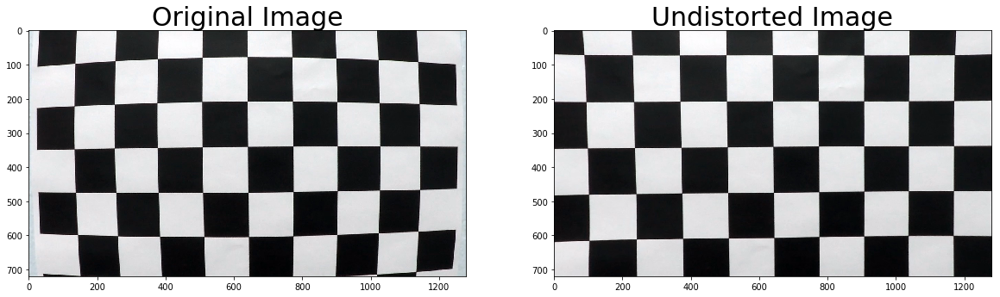

In [3]:
%matplotlib inline

img = cv2.imread('camera_cal/calibration1.jpg')
undist_img = cv2.undistort(img, mtx, dist, None, mtx)

#Display a comparison between the distorted and undistorted images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undist_img)
ax2.set_title('Undistorted Image', fontsize=30)

Ok! Seems like our parameters were properly saved in the *pickled* file and we properly restored them from there. Before we move on to the next steps, let's just make a helper function that will undistort a given image.

In [4]:
def undistort(img):
    return cv2.undistort(img, mtx, dist, None, mtx)

## 4. Perspective Transform

In order to perform *perspective transform*, we need to find a rectangle that covers our lane lines in most of the situations, define that rectangle with 4 points on the image, and then warp those. Also, something to note is that we will first need to *undistort* our images first, in order to preserve the correct shapes of the objects (lines) from the source image.

In [5]:
test_img = mpimg.imread('test_images/straight_lines1.jpg')
test_img_size = (test_img.shape[1], test_img.shape[0])

x1, y1 = (500, 480)
x2, y2 = (780, 480)
x3, y3 = (1200, 670)
x4, y4 = (80, 670)

src = np.float32(
    [[x1, y1],
     [x2, y2],
     [x3, y3],
     [x4, y4]])

offset = 10
dst = np.float32(
    [[offset, offset],
     [test_img_size[0] - offset, offset],
     [test_img_size[0] - offset, test_img_size[1] - offset],
     [offset, test_img_size[1] - offset]])

M = cv2.getPerspectiveTransform(src, dst)

In [6]:
def warp(img):
    img_size = (img.shape[1], img.shape[0])
    
    img = undistort(img)
    warped_img = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped_img

## 3. Color and Gradient Thresholds

Now we move on to applying some different color spaces and gradient thresholds to the images.

In [7]:
os.listdir("test_images/")

['challenge_lines1.jpg',
 'challenge_lines2.jpg',
 'harder_challenge_lines1.jpg',
 'harder_challenge_lines2.jpg',
 'harder_challenge_lines3.jpg',
 'harder_challenge_lines4.jpg',
 'harder_challenge_lines5.jpg',
 'harder_challenge_lines6.jpg',
 'harder_challenge_lines7.jpg',
 'harder_challenge_lines8.jpg',
 'straight_lines1.jpg',
 'straight_lines2.jpg',
 'test1.jpg',
 'test2.jpg',
 'test3.jpg',
 'test4.jpg',
 'test5.jpg',
 'test6.jpg']

Let's see how the HSV and HLS color spaces behave on some of the test images that we have.

After seeing some of the examples, it is clear that the **Saturation** channels from HSV and HLS are different and produce different results. That being said, it seems like the **HLS Saturation** and **HSV Value** channels are the ones that produce the most consistent results in terms of highlighting the lines. Therefore, we will move on with some thresholding experiments on them.

In [8]:
def line_color_filter(img):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    
    yellow_mask = cv2.inRange(hsv, np.array([20, 50, 50]), np.array([40, 255, 255]))
    white_mask = cv2.inRange(hsv, np.array([0, 0, 200]), np.array([255, 50, 255]))
    
    return cv2.bitwise_and(warped_img, warped_img, mask= white_mask | yellow_mask)

We will define the three types of sobel gradients here, and later combine them together. All of the sobel helpers will receive as an input a 1 channel image (most likely one of the HSVor HLS channels).

In [9]:
def abs_sobel_thresh(img_channel, orient='x', sobel_kernel=3, thresh=(0, 255)):
    sobel = np.zeros(img_channel.shape)
    
    if orient == 'x':
        sobel = cv2.Sobel(img_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif orient == 'y':
        sobel = cv2.Sobel(img_channel, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return binary_output   

In [10]:
def mag_sobel_thresh(img_channel, sobel_kernel=3, thresh=(0, 255)):
    sobelx = cv2.Sobel(img_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img_channel, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    magn_sobel = np.sqrt(sobelx ** 2 + sobely ** 2)
    scaled_sobel = np.uint8(255 * magn_sobel / np.max(magn_sobel))
    
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return binary_output

In [50]:
def dir_sobel_thresh(img_channel, sobel_kernel=3, thresh=(0, np.pi/2)):
    sobelx = cv2.Sobel(img_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img_channel, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    gradient_direction = np.uint8(np.arctan2(abs_sobely, abs_sobelx))
    
    binary_output = np.zeros_like(gradient_direction)
    binary_output[(gradient_direction >= thresh[0]) & (gradient_direction <= thresh[1])] = 1

    return binary_output

In [68]:
def lines_preprocessing(img, s_thresh=(200, 255), sx_thresh=(50, 100)):
    copy = np.copy(img)
    
    # Convert image to both HSV and HLS as described above
    hsv = cv2.cvtColor(copy, cv2.COLOR_RGB2HSV).astype(np.float)
    hls = cv2.cvtColor(copy, cv2.COLOR_RGB2HLS).astype(np.float)
       
    # Grab the HLS Saturation channel
    s_channel = hls[:,:,2]
    # Grab the HSV Value channel
    v_channel = hsv[:,:,2]
    
    gradx = abs_sobel_thresh(v_channel, orient='x', thresh=sx_thresh)
    grady = abs_sobel_thresh(v_channel, orient='y', thresh=sx_thresh)
    mag_binary = mag_sobel_thresh(v_channel, sobel_kernel=5, thresh=(200, 255))
    dir_binary = dir_sobel_thresh(v_channel, sobel_kernel=5, thresh=(np.pi/4, 3 * np.pi / 4))
    
    combined_thresh = np.zeros_like(v_channel)
    combined_thresh[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    # Threshold Saturation channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    color_binary = np.dstack((np.zeros_like(combined_thresh), combined_thresh, s_binary))
    return color_binary

challenge_lines1.jpg


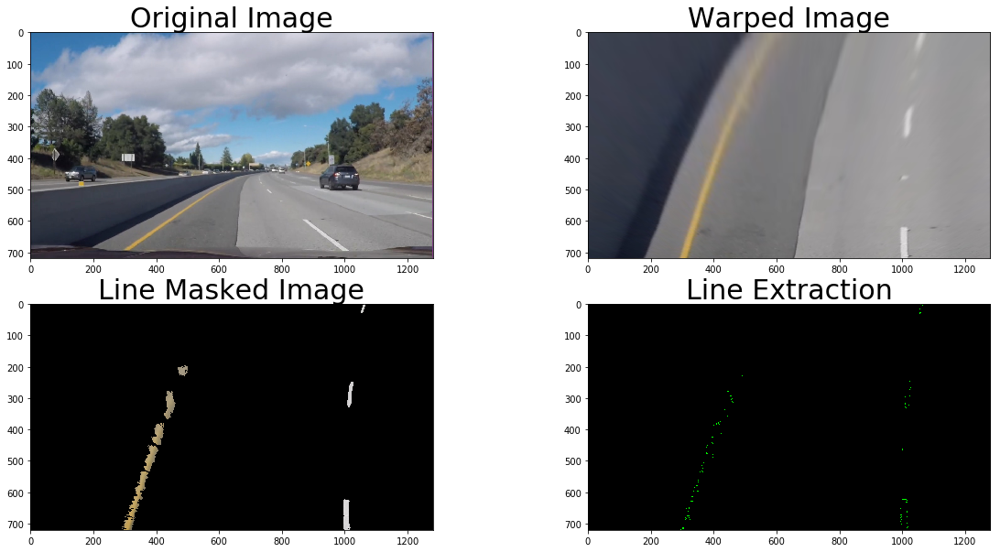

challenge_lines2.jpg


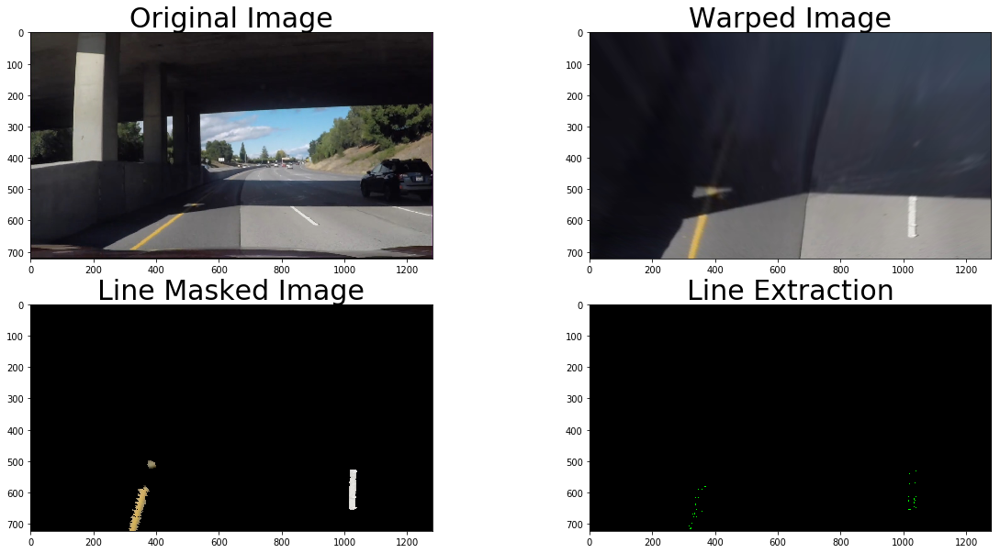

harder_challenge_lines1.jpg


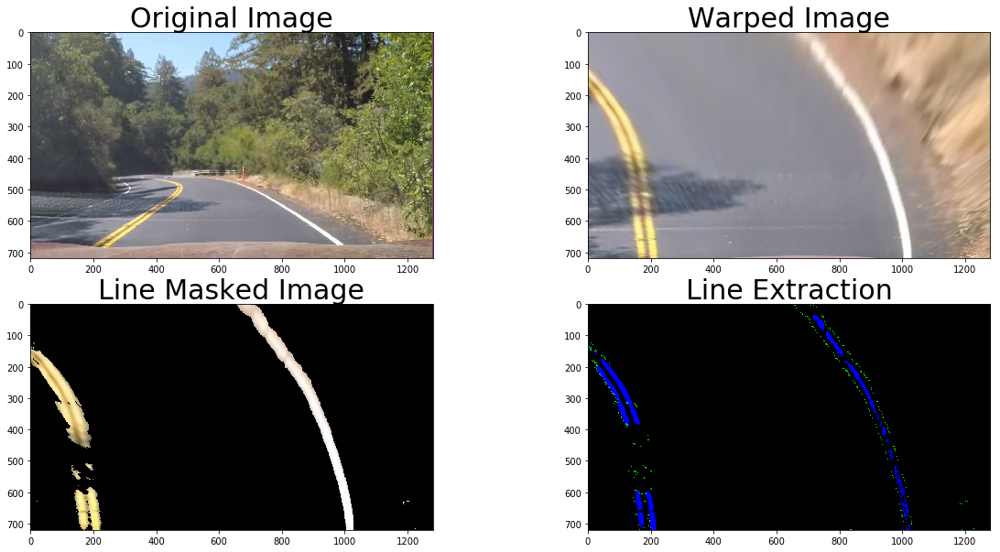

harder_challenge_lines2.jpg


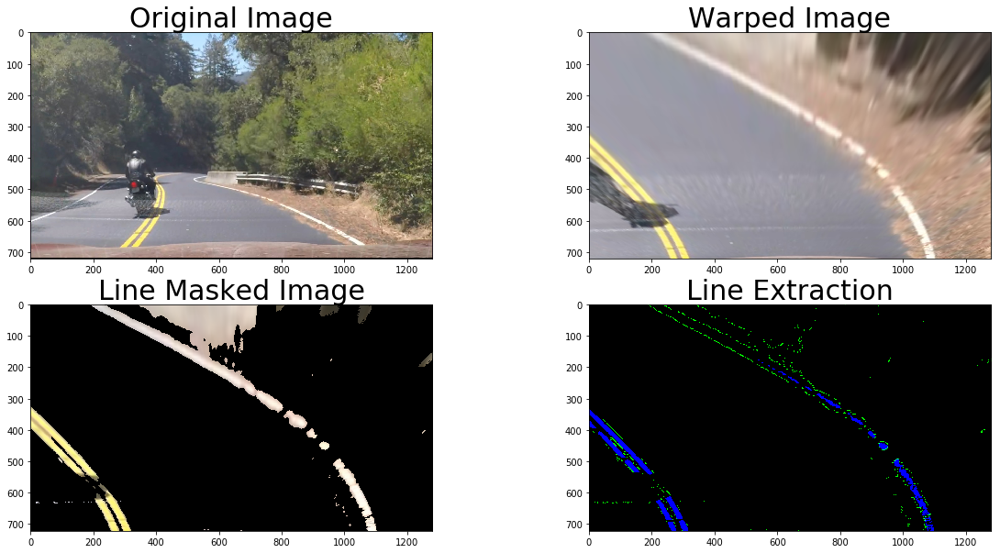

harder_challenge_lines3.jpg


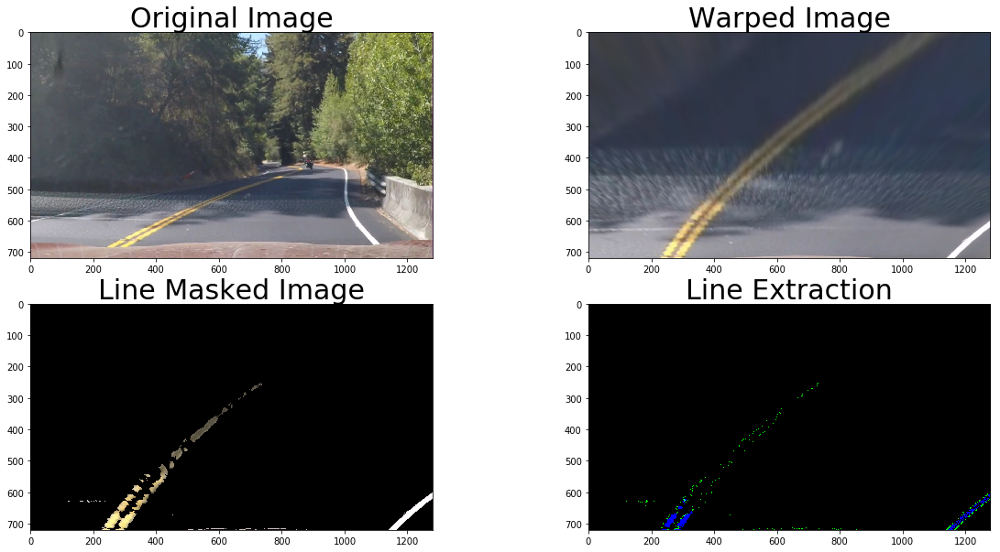

harder_challenge_lines4.jpg


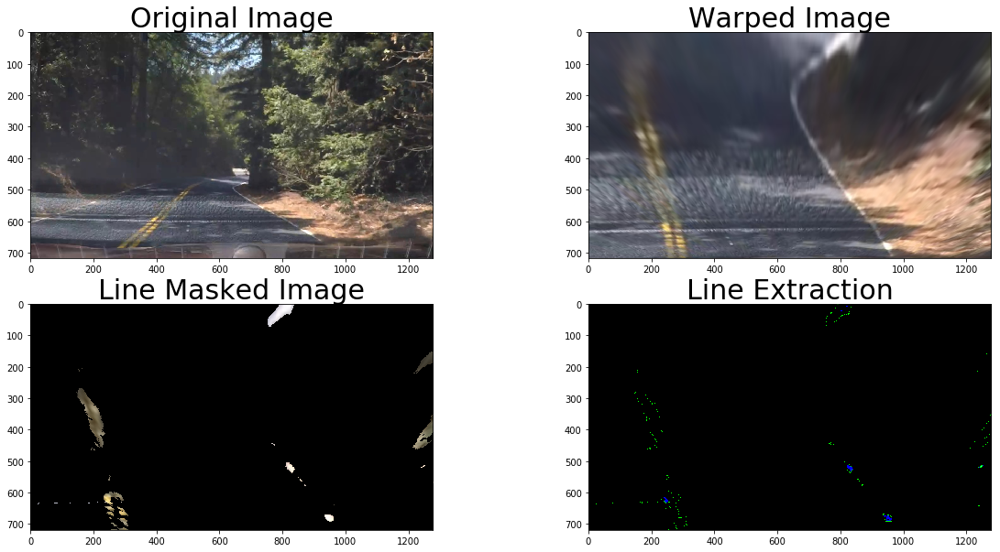

harder_challenge_lines5.jpg


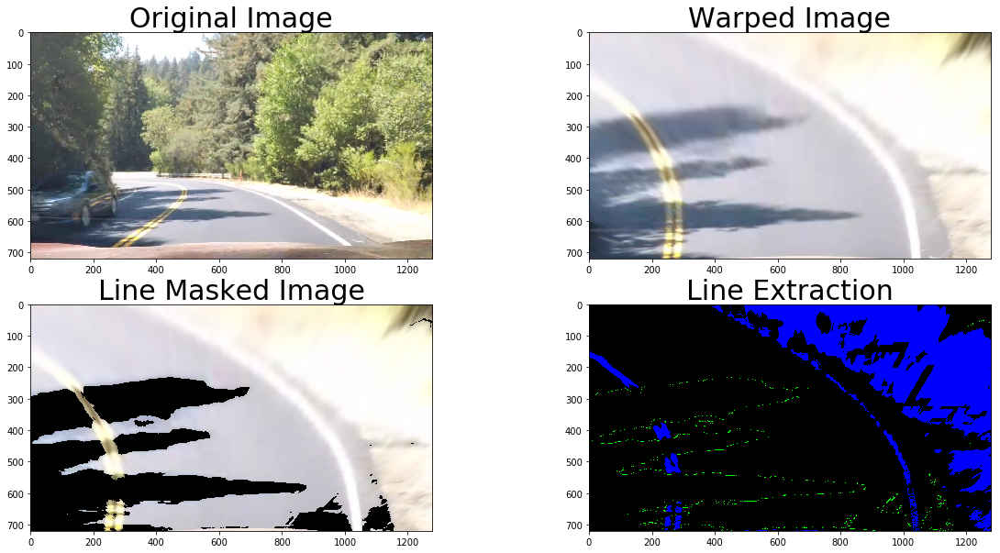

harder_challenge_lines6.jpg


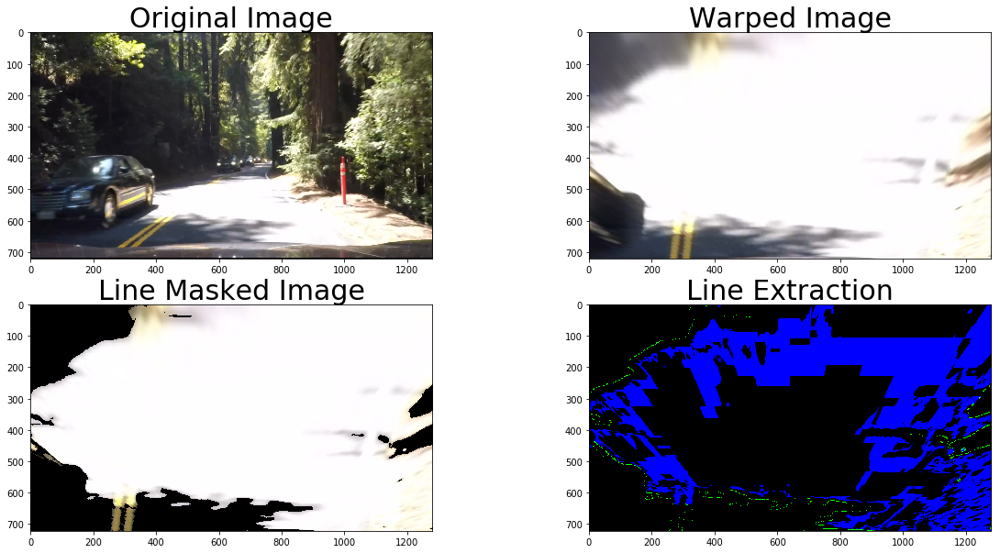

harder_challenge_lines7.jpg


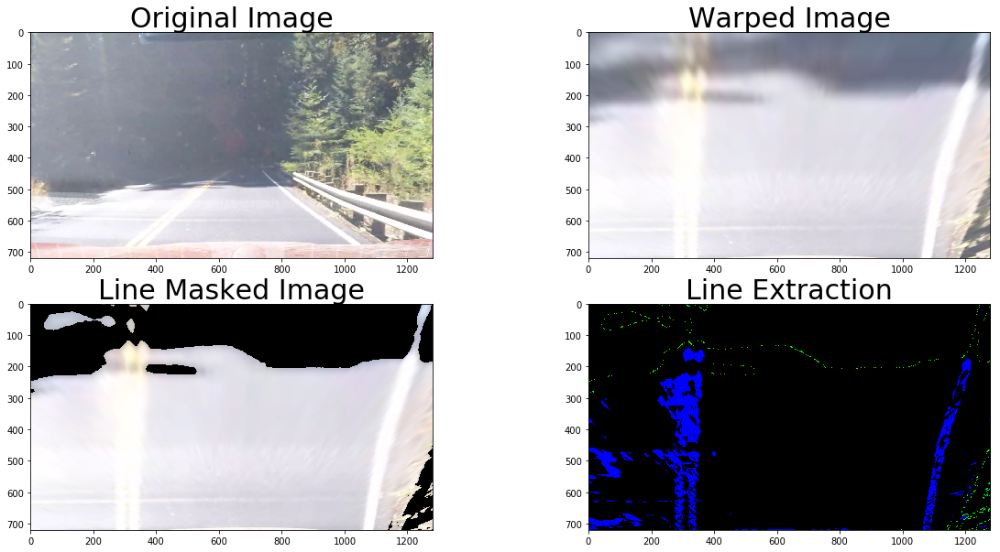

harder_challenge_lines8.jpg


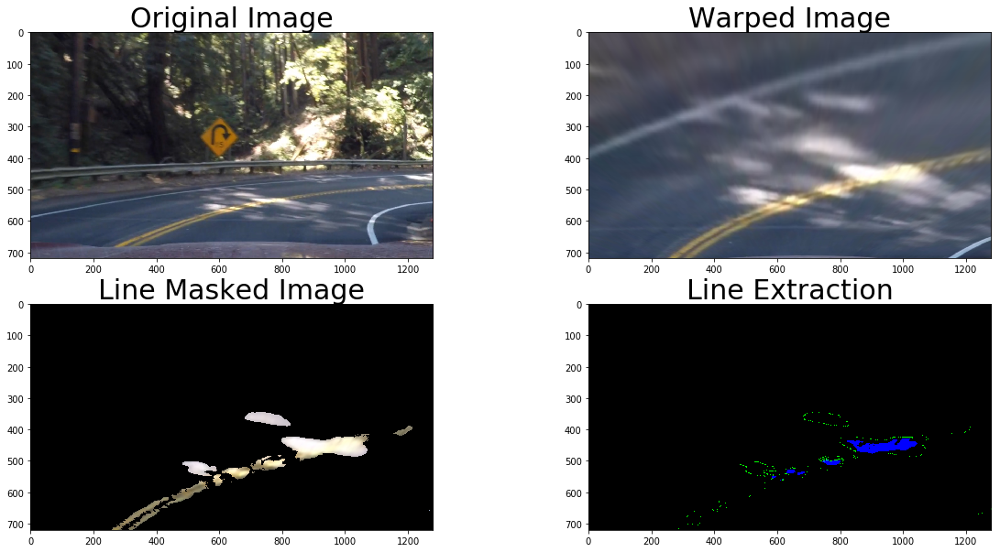

straight_lines1.jpg


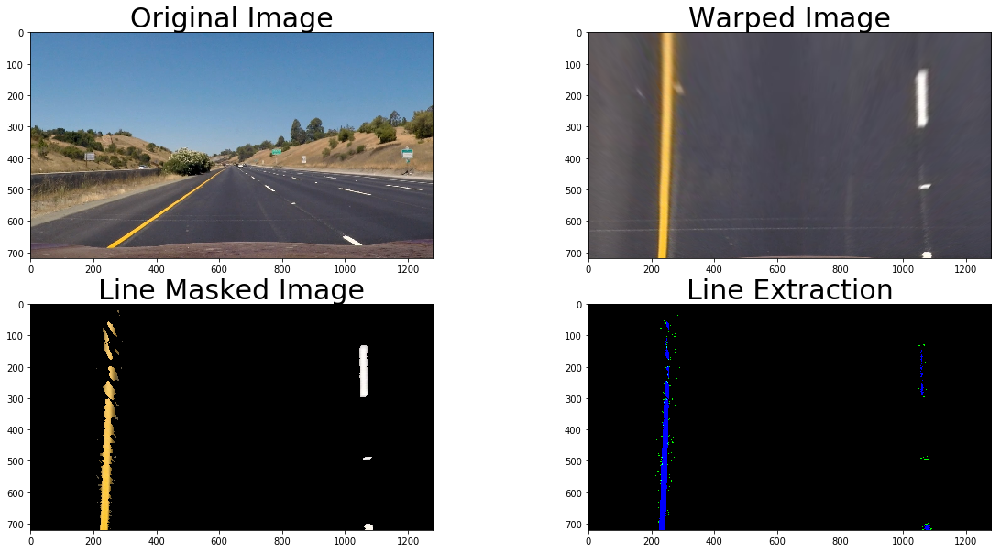

straight_lines2.jpg


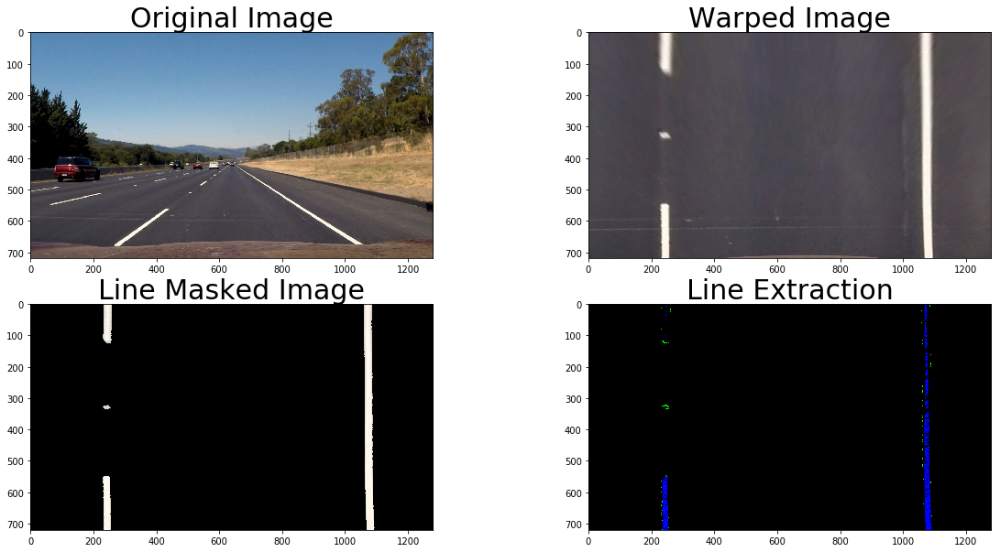

test1.jpg


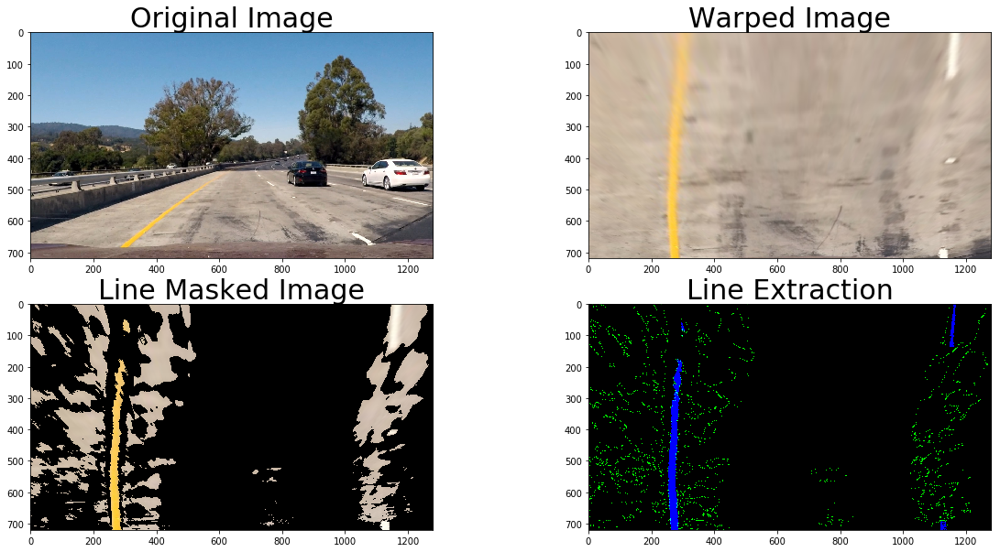

test2.jpg


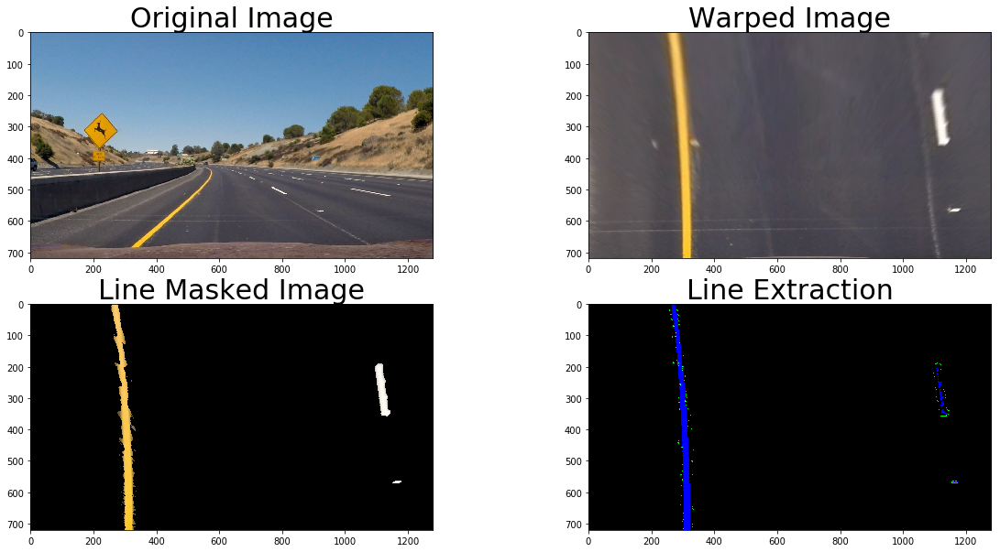

test3.jpg


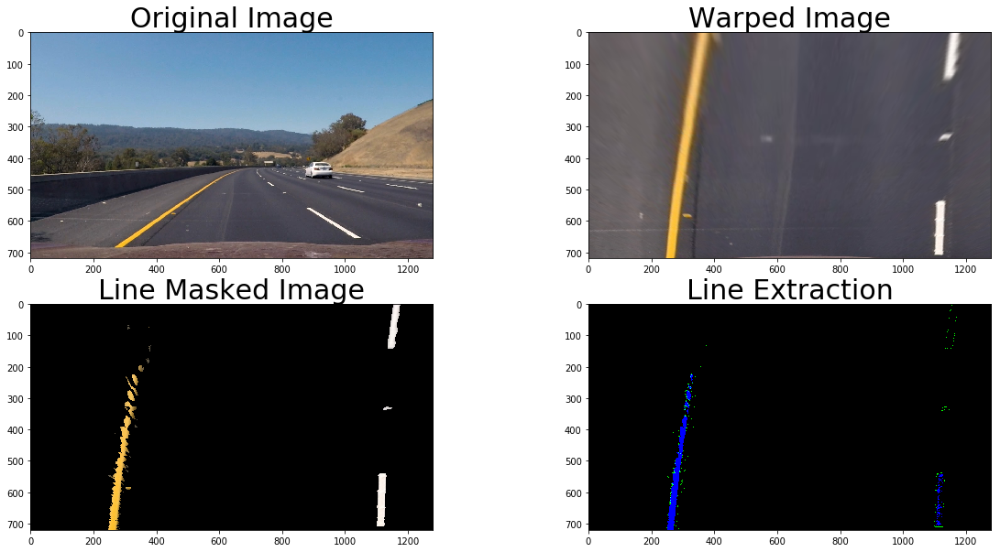

test4.jpg


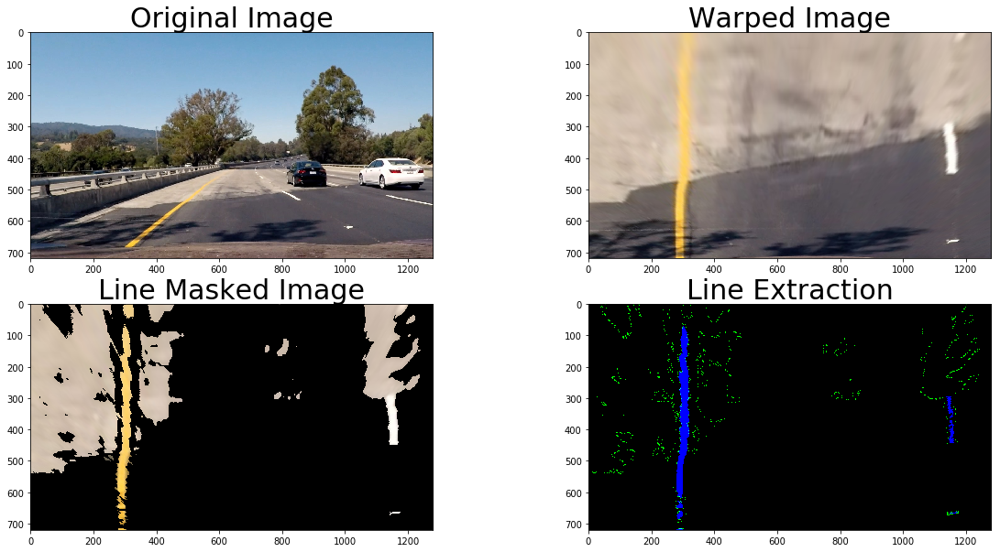

test5.jpg


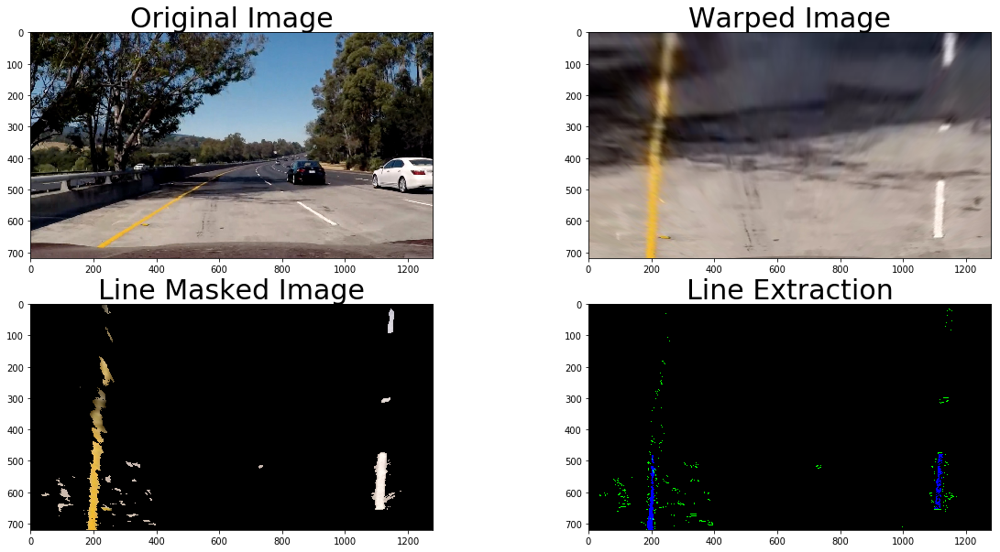

test6.jpg


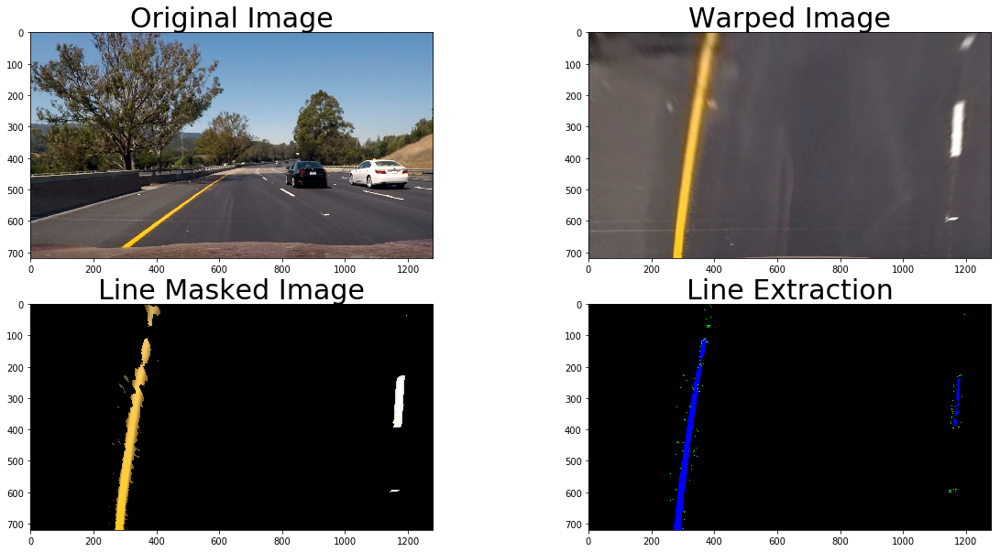

In [69]:
for image_name in os.listdir('test_images/'):
    print(image_name)
    
    img = mpimg.imread('test_images/' + image_name)
    warped_img = warp(img)
    masked_img = line_color_filter(warped_img)
    lines_img = lines_preprocessing(masked_img)
    
    f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 10))
    
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(warped_img)
    ax2.set_title('Warped Image', fontsize=30)
    ax3.imshow(masked_img)
    ax3.set_title('Line Masked Image', fontsize=30)
    ax4.imshow(lines_img)
    ax4.set_title('Line Extraction', fontsize=30)
    plt.show()

## 5. Detect Lane Lines

Now that we applied the perspective transform on the images and we highlighted the lines, ignoring anything else, we can go ahead and try to detect where the lane lines are.

In [78]:
def convert_to_binary(channels_binary_img):
    binary_img = np.zeros_like(lines_img[:,:,1])
    binary_img[(lines_img[:,:,1] == 1) | (lines_img[:,:,2] == 1)] = 1
    return binary_img

In [79]:
def get_histogram(binary_img, factor=1.5):
    return np.sum(binary_img[int(binary_img.shape[0]//factor):,:], axis=0)

Now test the histogram on the test images, to see how it looks for each of the cases I tried to capture in the test images.

challenge_lines1.jpg


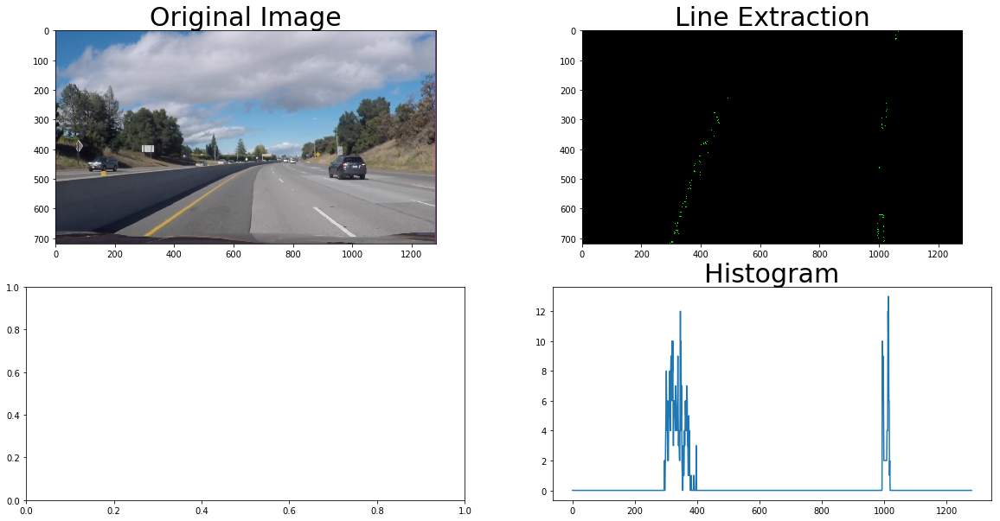

challenge_lines2.jpg


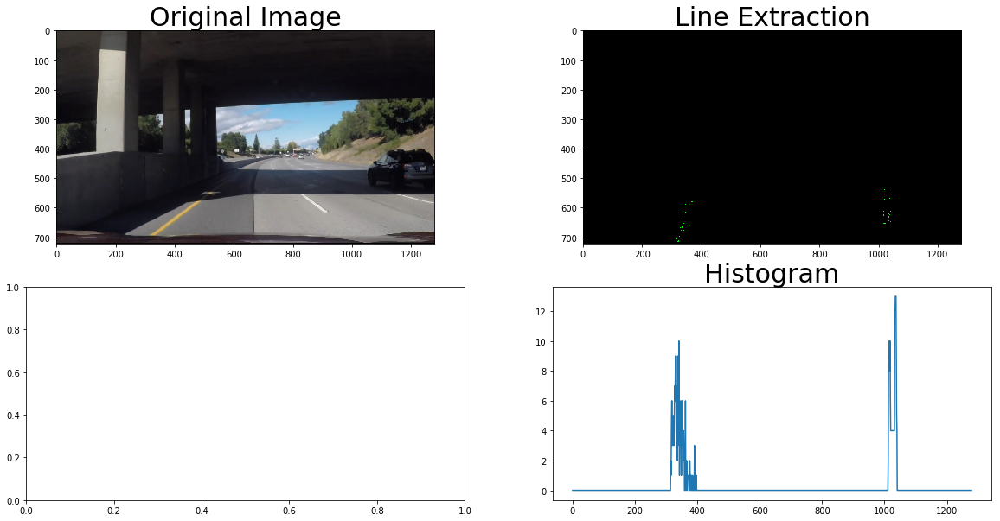

harder_challenge_lines1.jpg


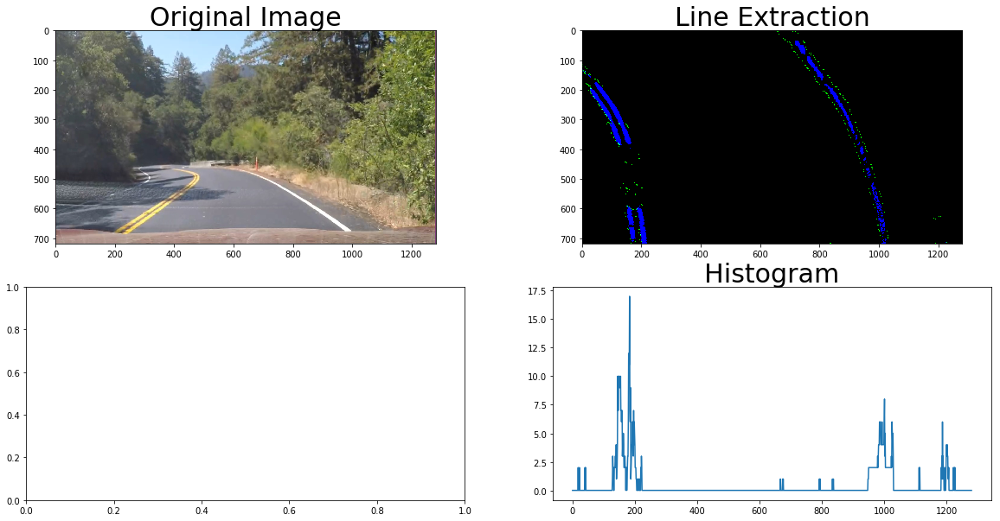

harder_challenge_lines2.jpg


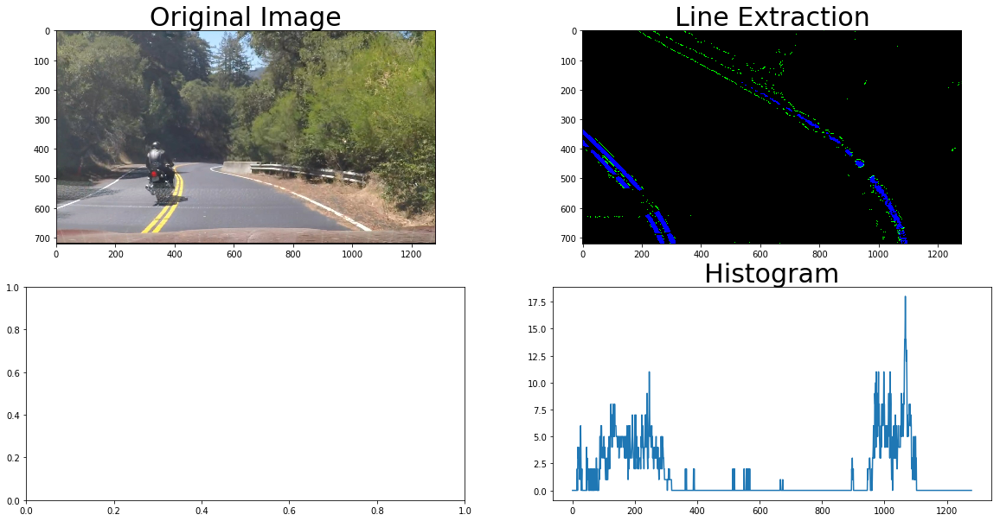

harder_challenge_lines3.jpg


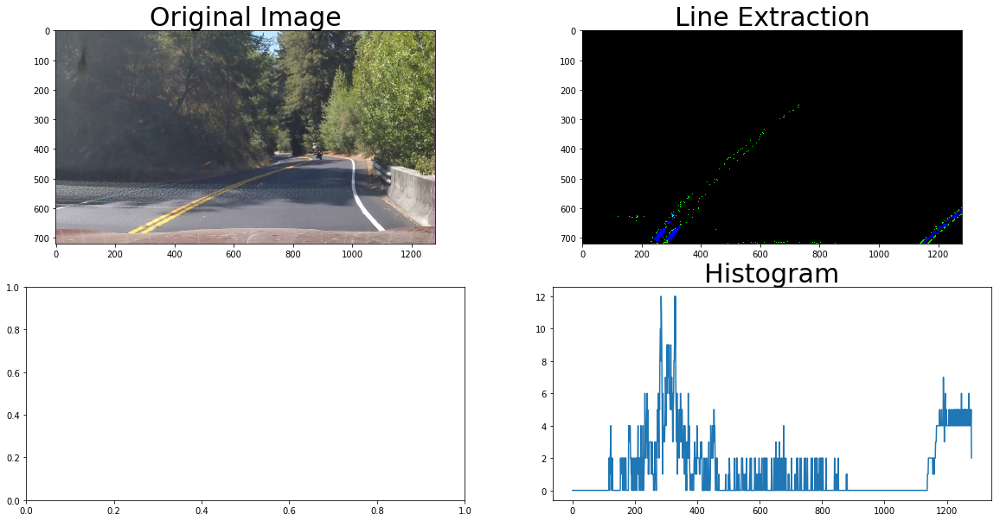

harder_challenge_lines4.jpg


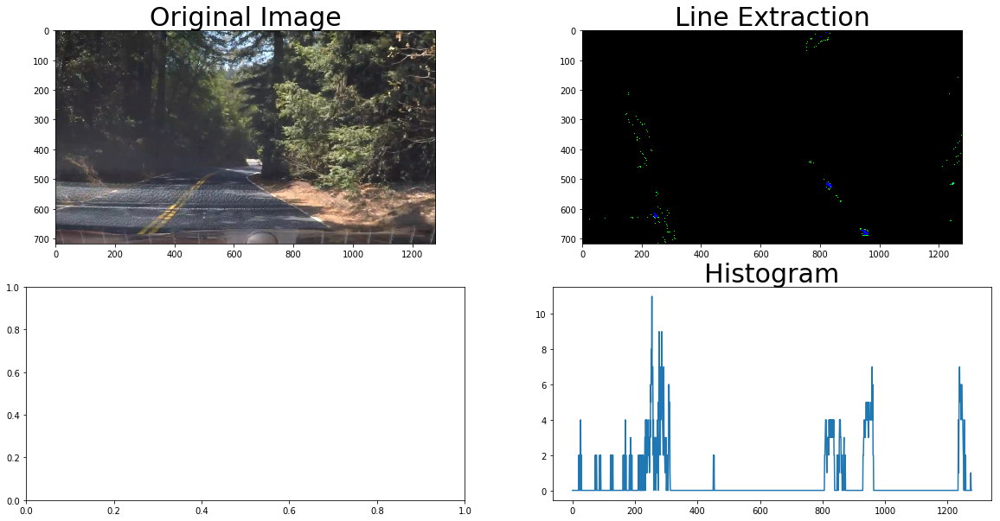

harder_challenge_lines5.jpg


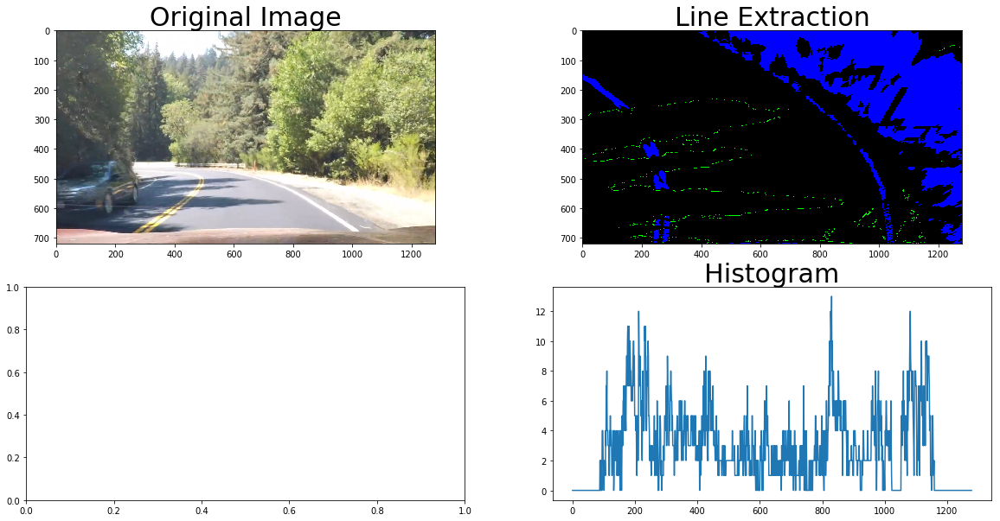

harder_challenge_lines6.jpg


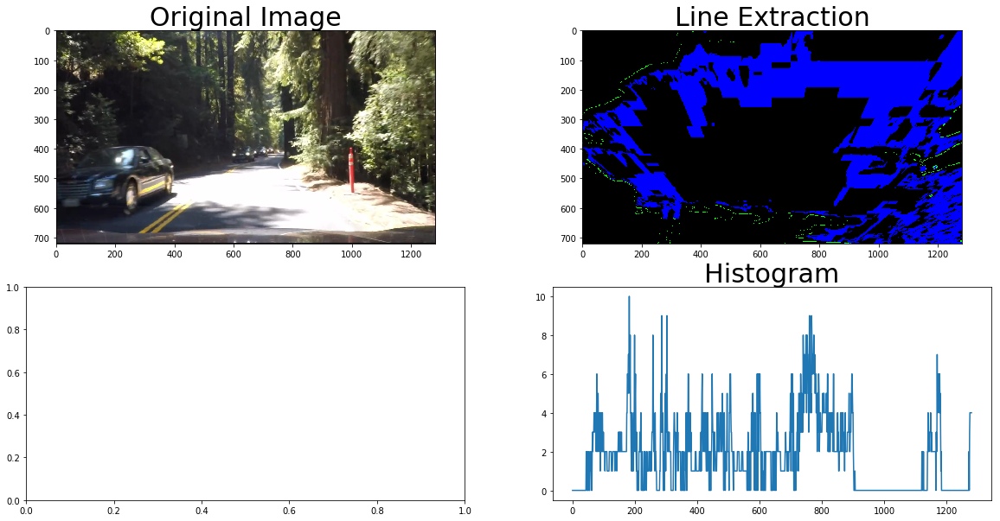

harder_challenge_lines7.jpg


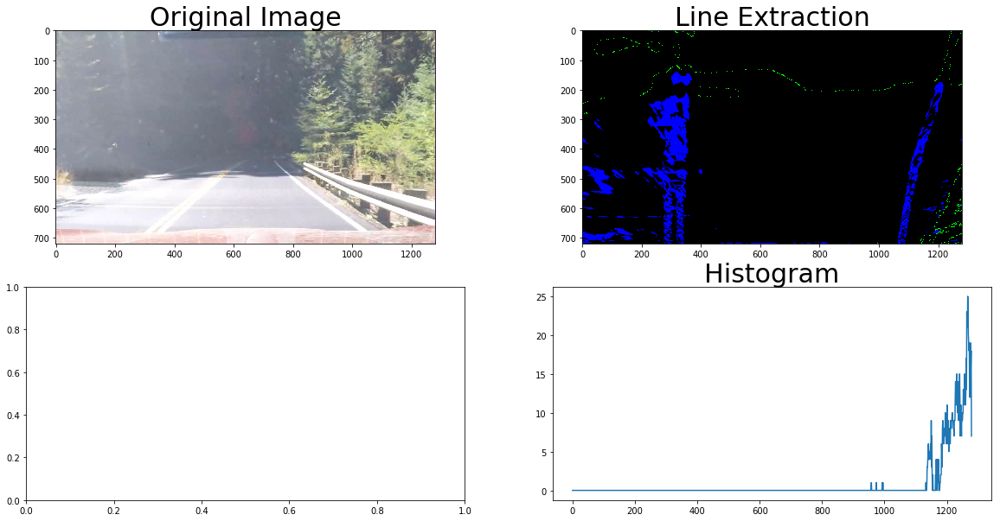

harder_challenge_lines8.jpg


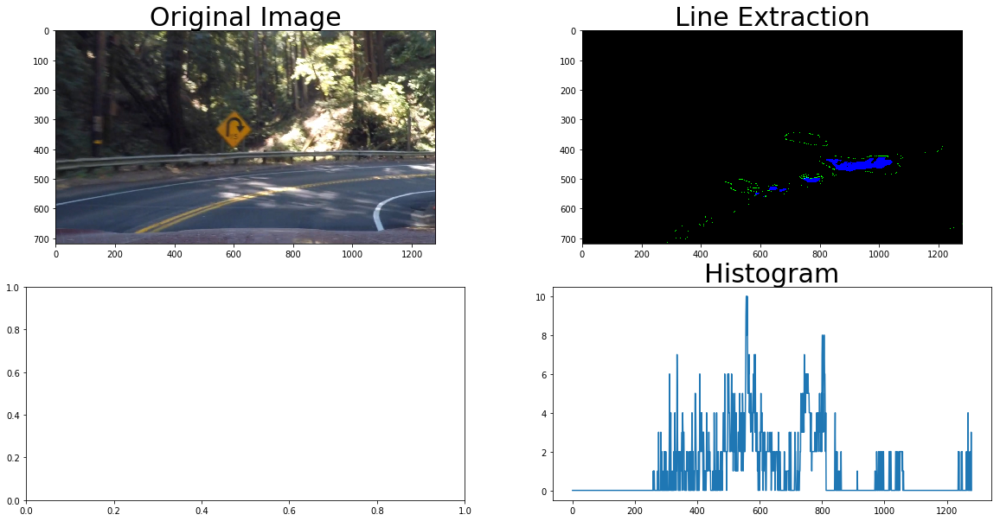

straight_lines1.jpg


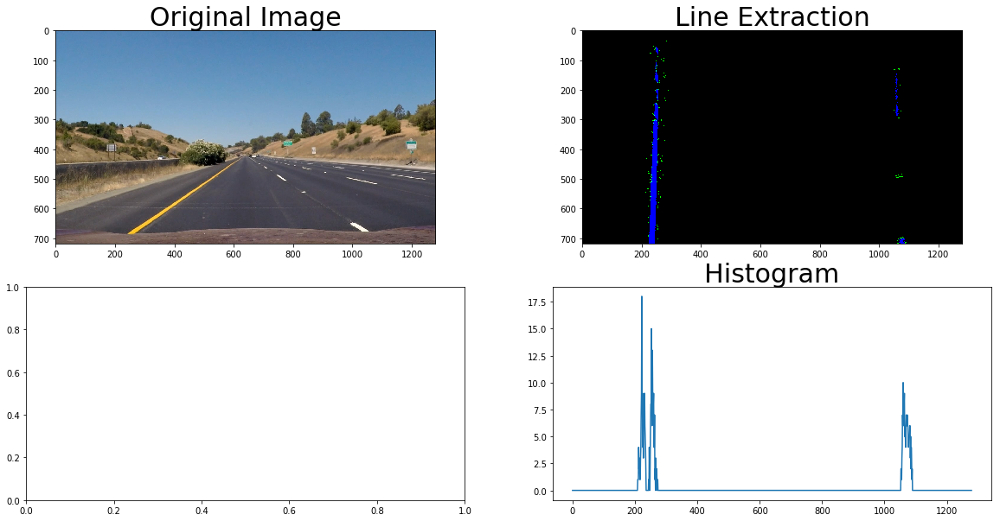

straight_lines2.jpg


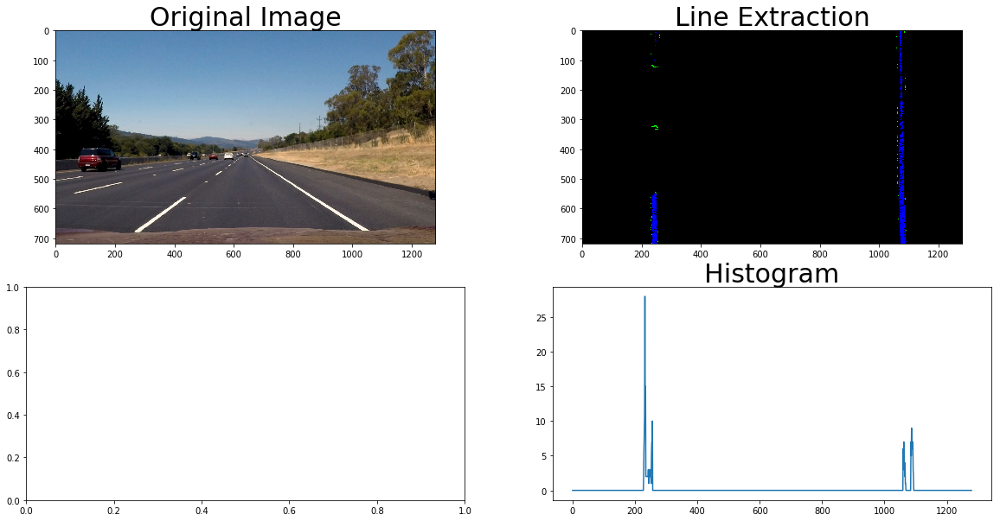

test1.jpg


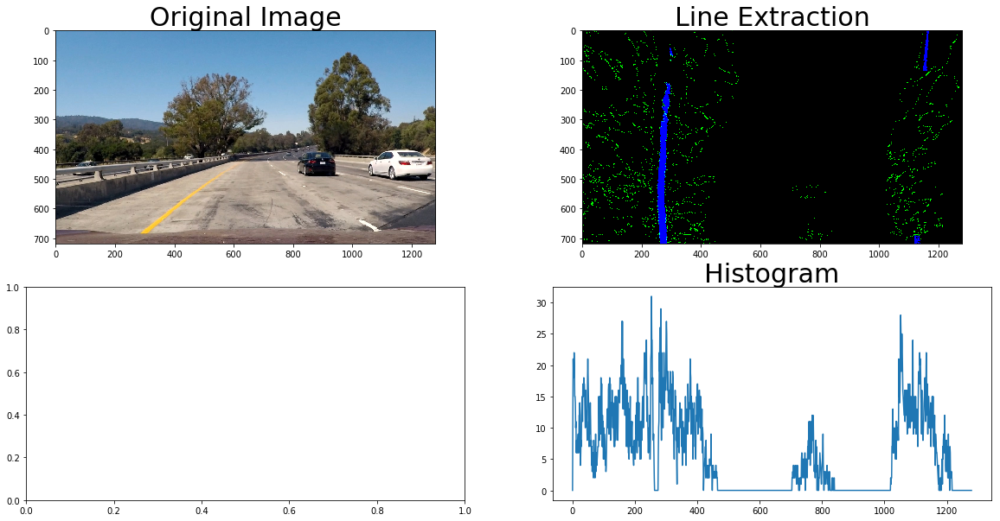

test2.jpg


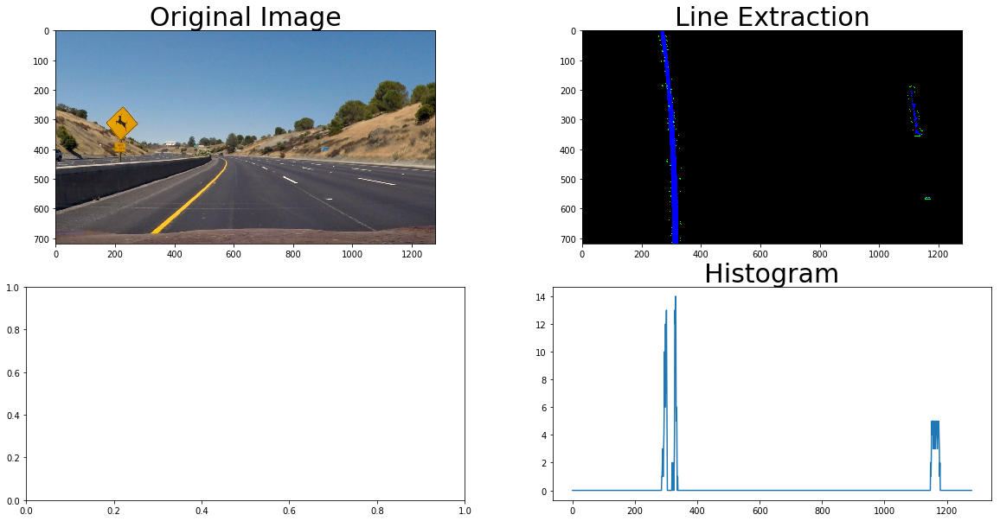

test3.jpg


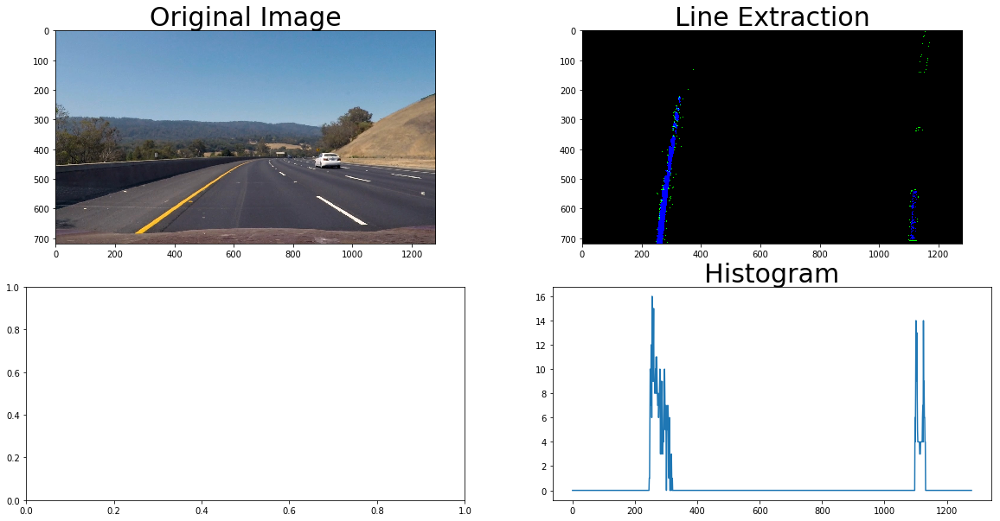

test4.jpg


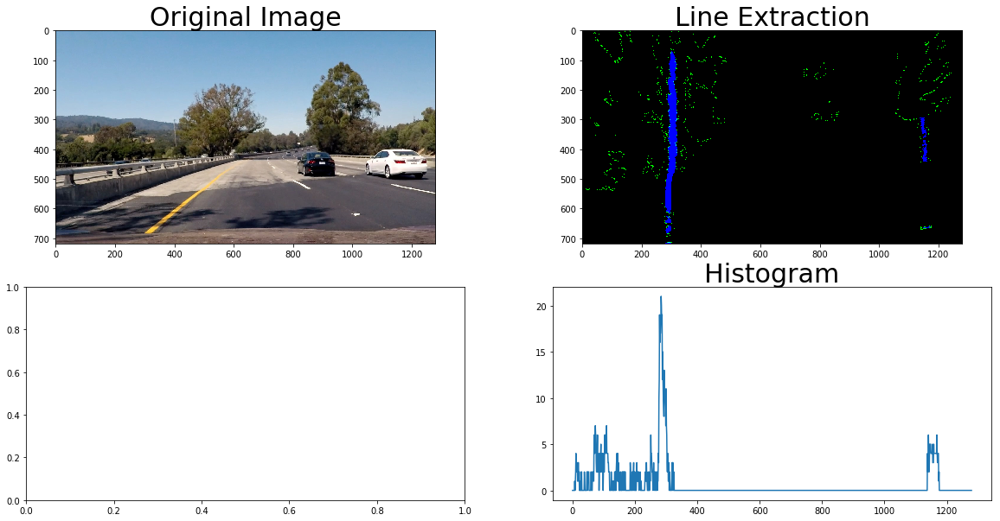

test5.jpg


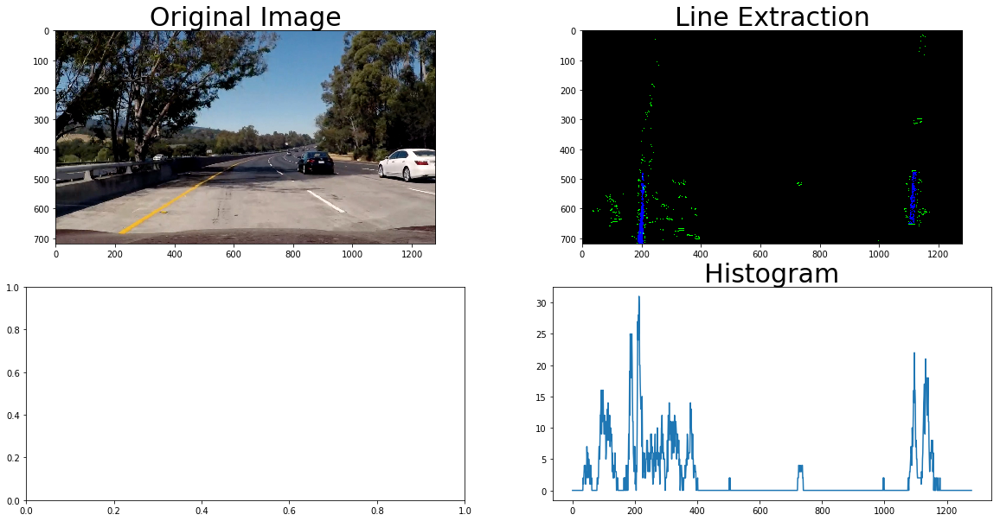

test6.jpg


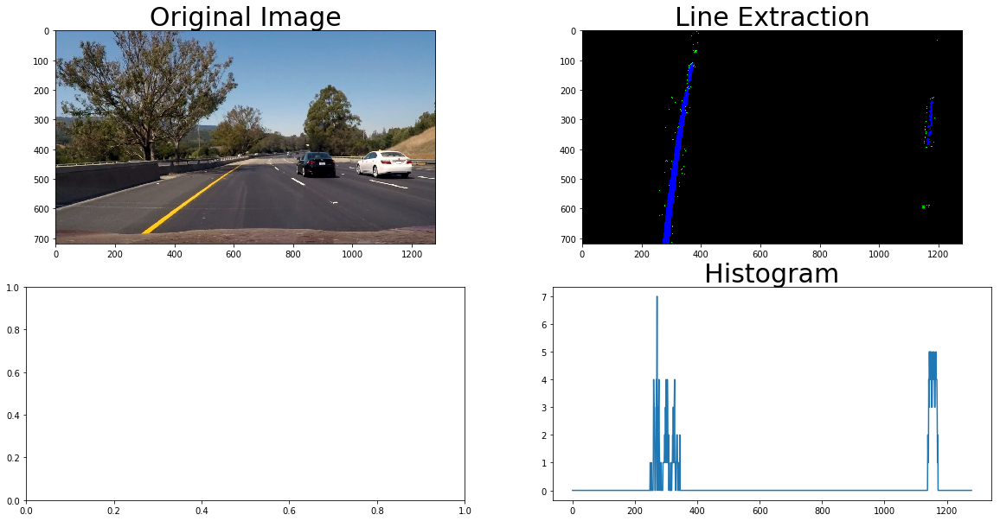

In [70]:
for image_name in os.listdir('test_images/'):
    print(image_name)
    
    img = mpimg.imread('test_images/' + image_name)
    warped_img = warp(img)
    masked_img = line_color_filter(warped_img)
    lines_img = lines_preprocessing(masked_img)
    histogram = get_histogram(lines_img)
    
    f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 10))
    
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lines_img)
    ax2.set_title('Line Extraction', fontsize=30)
    ax4.plot(histogram)
    ax4.set_title('Histogram', fontsize=30)
    plt.show()

With the histogram ready, we can move on to actually finding the lines. We will do this by using the sliding windows approach and then fitting a polynomial along the detected points.

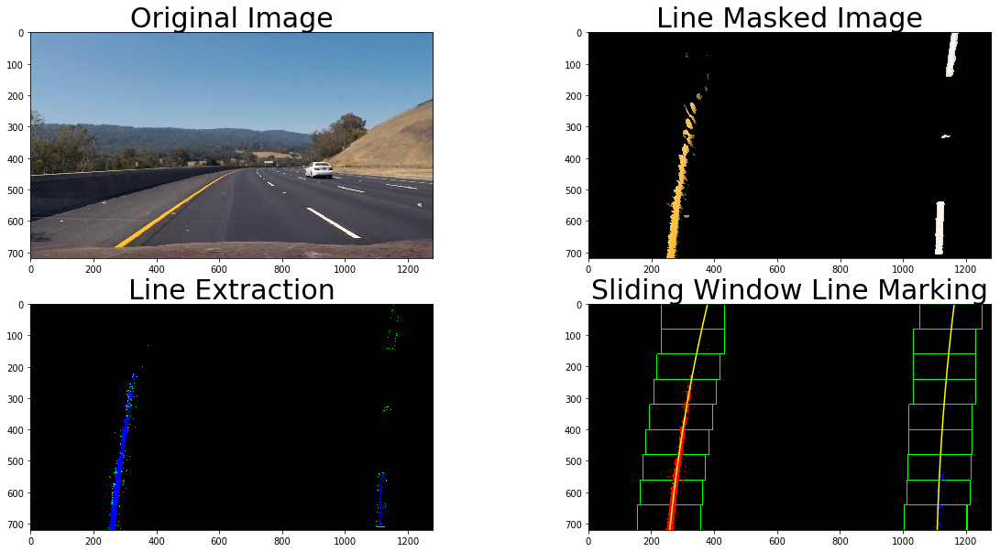

In [75]:
test_img1 = mpimg.imread('test_images/challenge_lines1.jpg')
test_img2 = mpimg.imread('test_images/harder_challenge_lines1.jpg')
test_img3 = mpimg.imread('test_images/test3.jpg')

img = test_img3

warped_img = warp(img)
masked_img = line_color_filter(warped_img)
lines_img = lines_preprocessing(masked_img)

# Convert warped masked image to binary
binary_img = np.zeros_like(np.uint8(lines_img[:,:,1]))
binary_img[(lines_img[:,:,1] == 1) | (lines_img[:,:,2] == 1)] = 1

# Assuming you have created a warped binary image called "binary_warped"
# Take a histogram of the bottom half of the image
histogram = get_histogram(lines_img)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_img, binary_img, binary_img)) * 255

# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(binary_img.shape[0]//nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_img.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_img.shape[0] - (window+1)*window_height
    win_y_high = binary_img.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

# Generate x and y values for plotting
ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 10))

ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(masked_img)
ax2.set_title('Line Masked Image', fontsize=30)
ax3.imshow(lines_img)
ax3.set_title('Line Extraction', fontsize=30)
ax4.imshow(out_img)
ax4.plot(left_fitx, ploty, color='yellow')
ax4.plot(right_fitx, ploty, color='yellow')
ax4.set_xlim(0, out_img.shape[1])
ax4.set_ylim(out_img.shape[0], 0)
ax4.set_title('Sliding Window Line Marking', fontsize=30)
plt.show()

In [81]:
def get_line_fits(lines_img, plot=False):
    # Convert warped masked image to binary
    lines_img = np.uint8(lines_img)
    binary_img = convert_to_binary(lines_img)

    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = get_histogram(binary_img)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_img, binary_img, binary_img)) * 255

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_img.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_img.shape[0] - (window+1)*window_height
        win_y_high = binary_img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    if plot == True:
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0] )
        left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
        right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        plt.show()
    
    return left_fit, right_fit

challenge_lines1.jpg


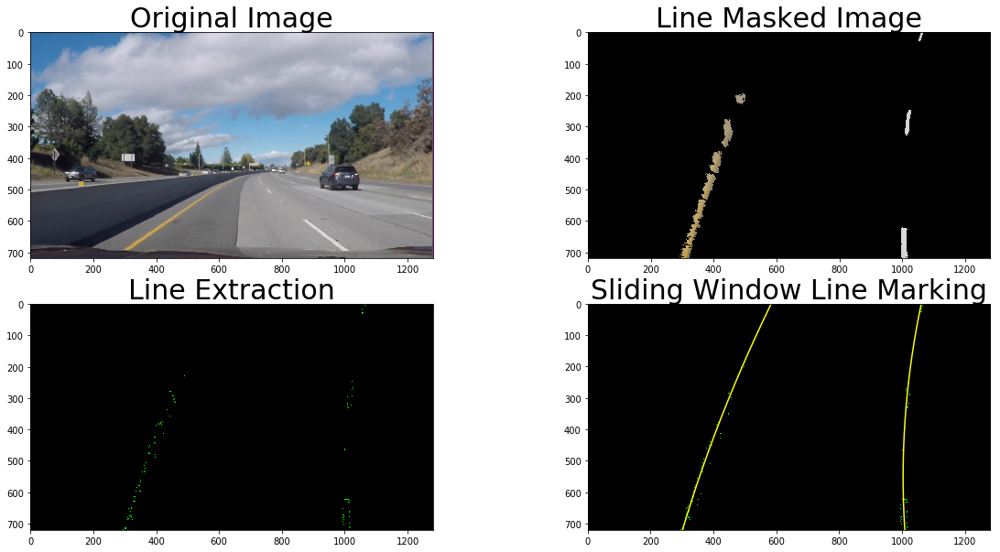

challenge_lines2.jpg


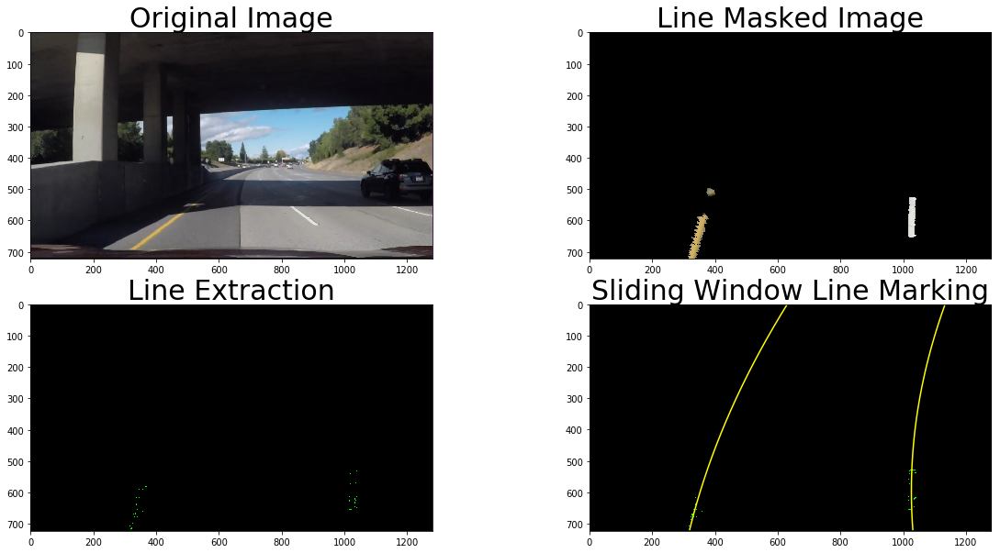

harder_challenge_lines1.jpg


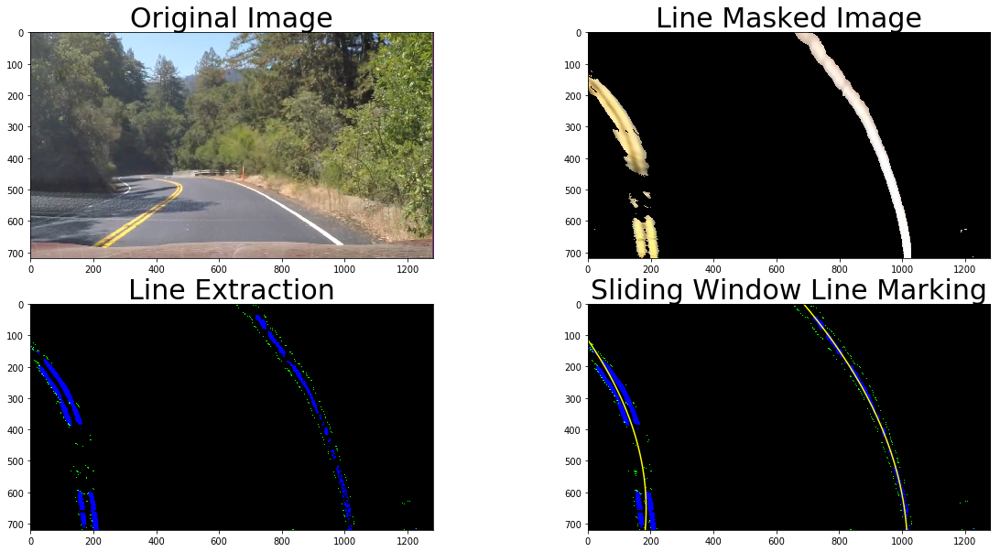

harder_challenge_lines2.jpg


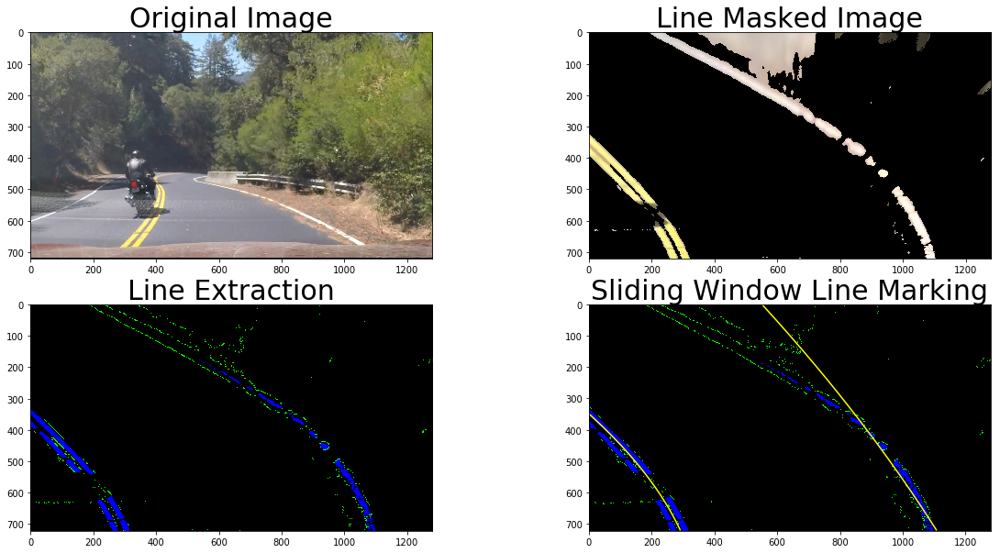

harder_challenge_lines3.jpg


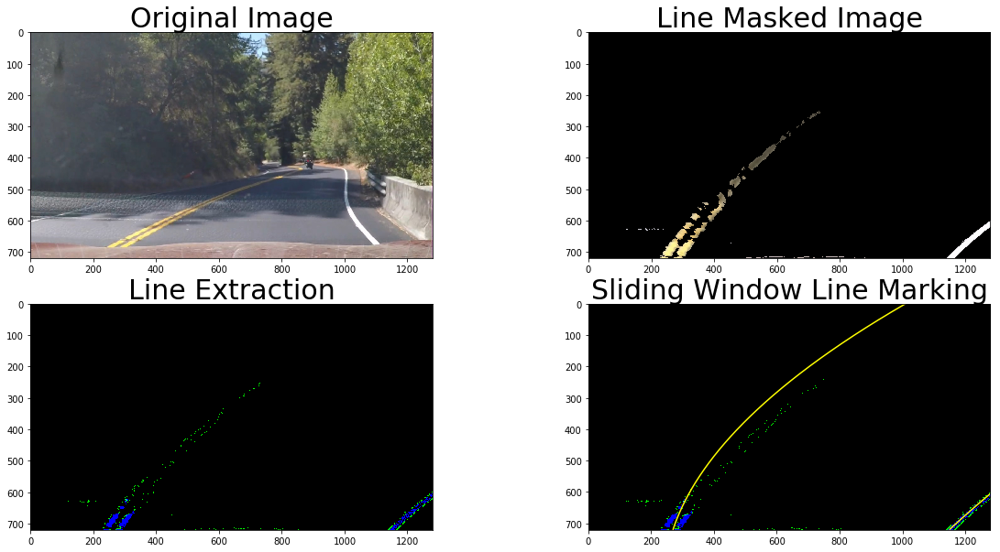

harder_challenge_lines4.jpg


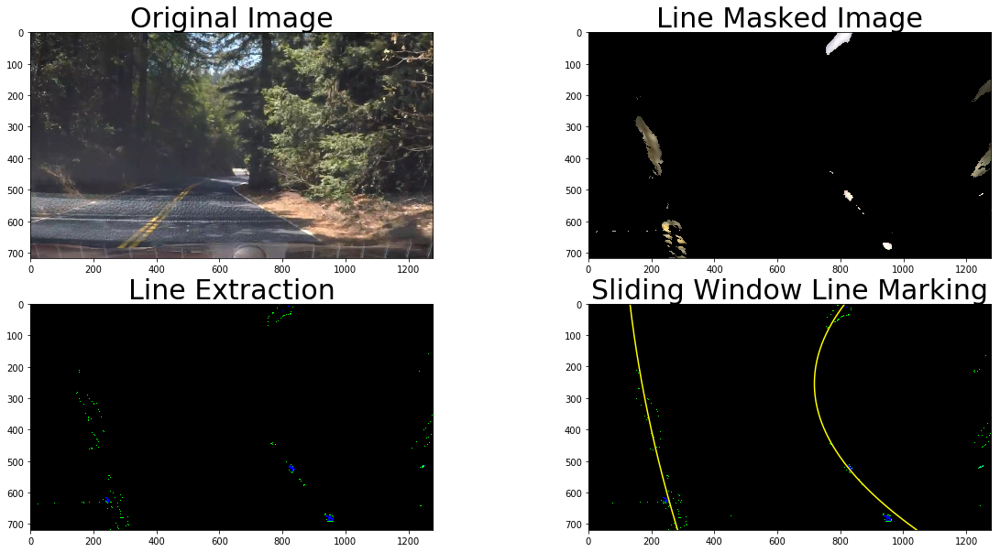

harder_challenge_lines5.jpg


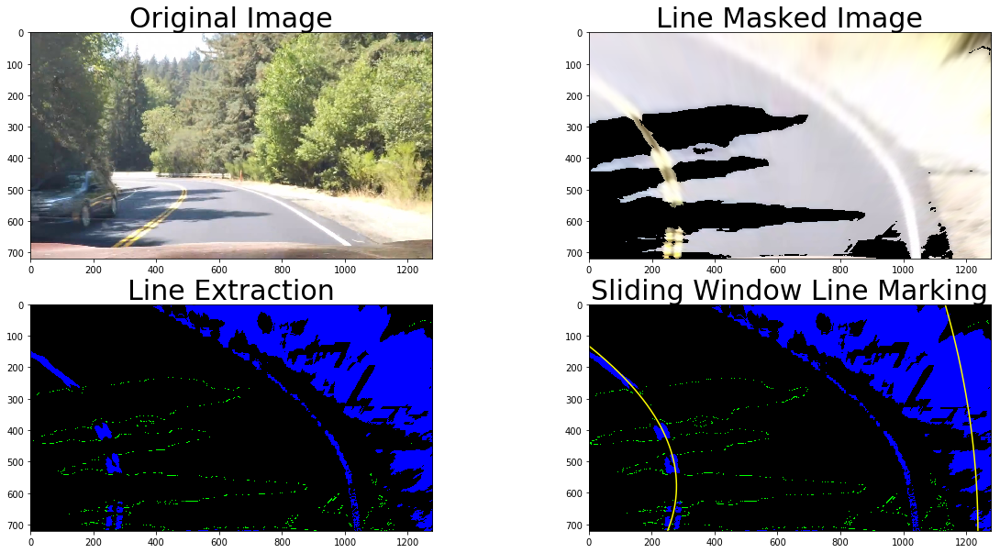

harder_challenge_lines6.jpg


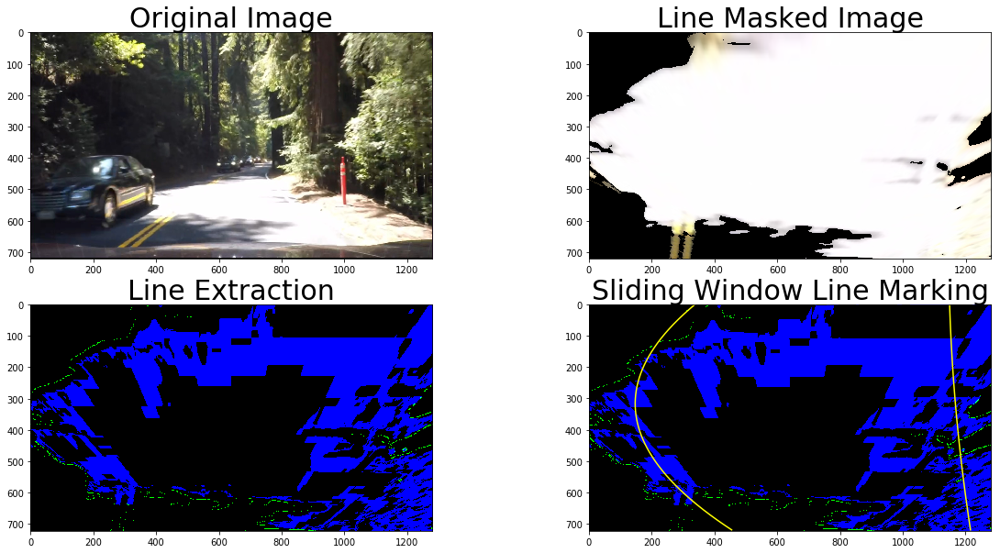

harder_challenge_lines7.jpg


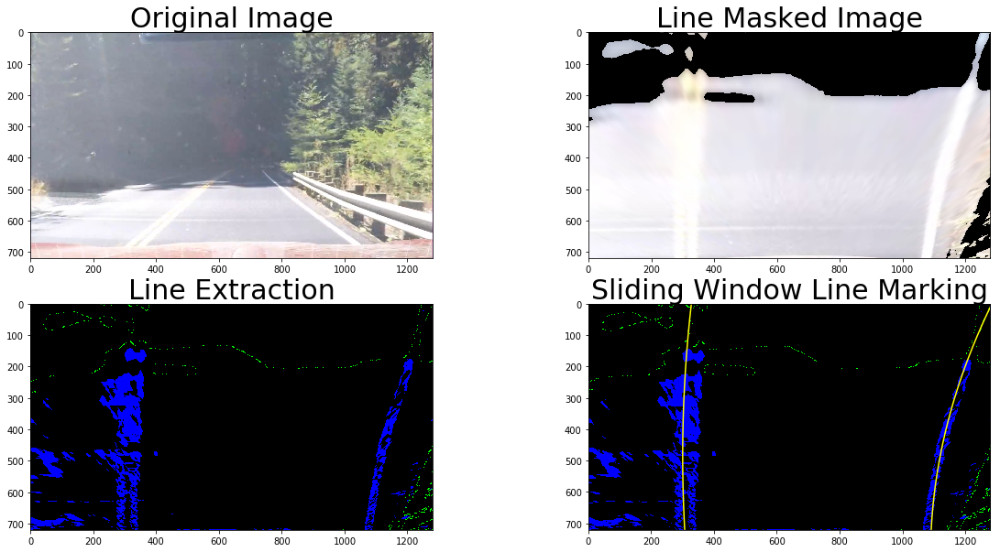

harder_challenge_lines8.jpg


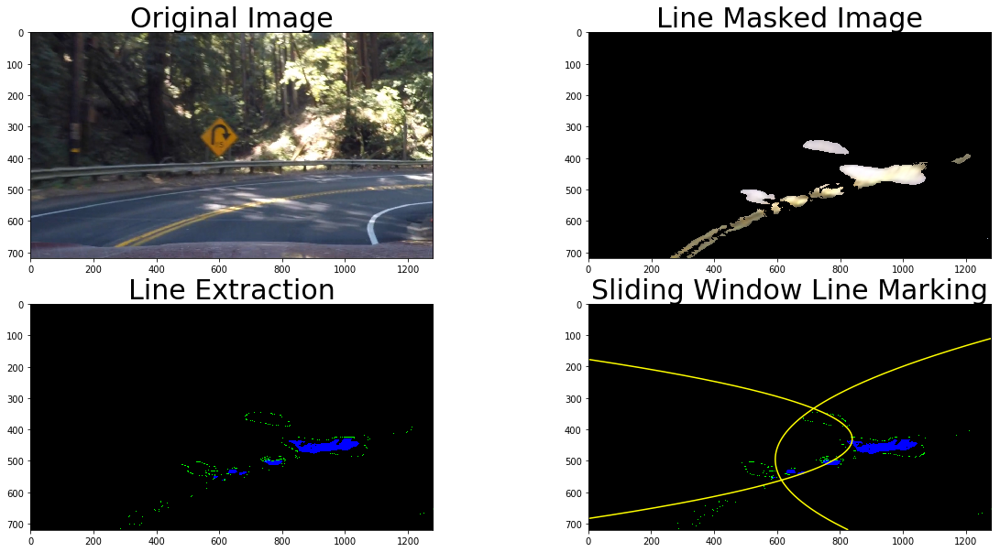

straight_lines1.jpg


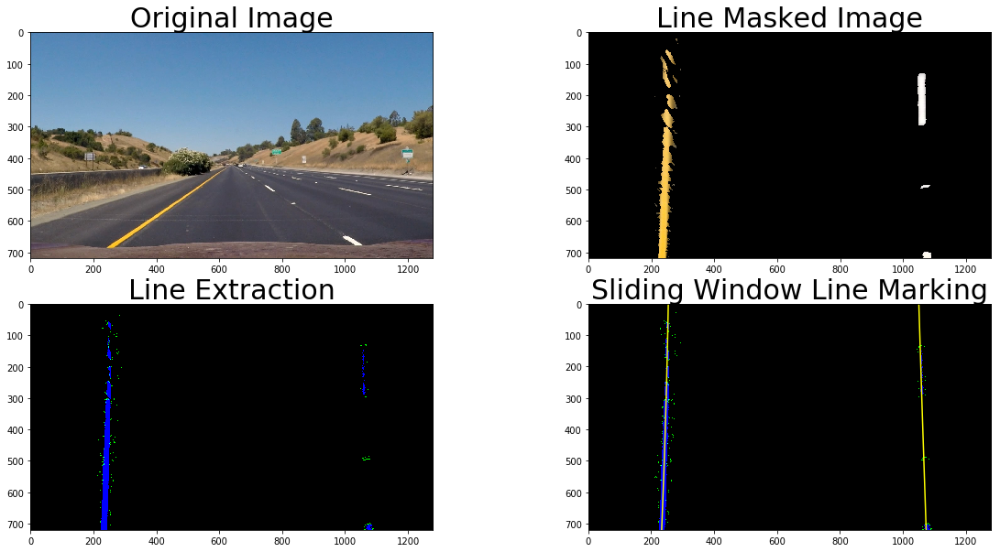

straight_lines2.jpg


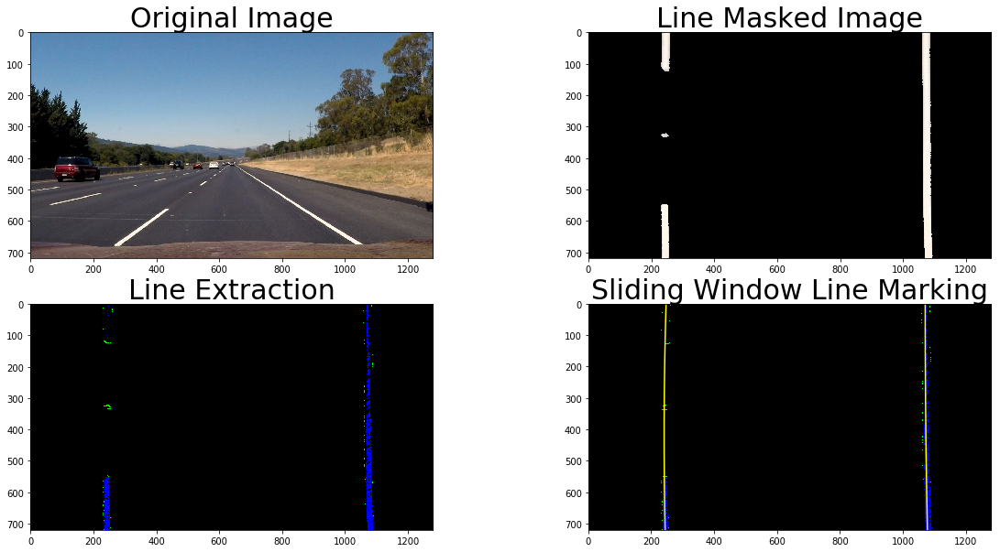

test1.jpg


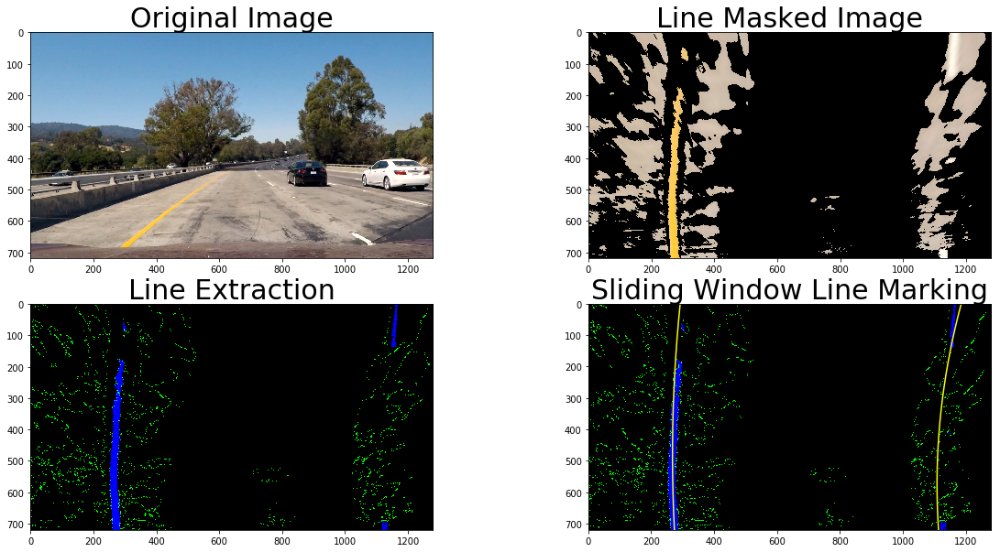

test2.jpg


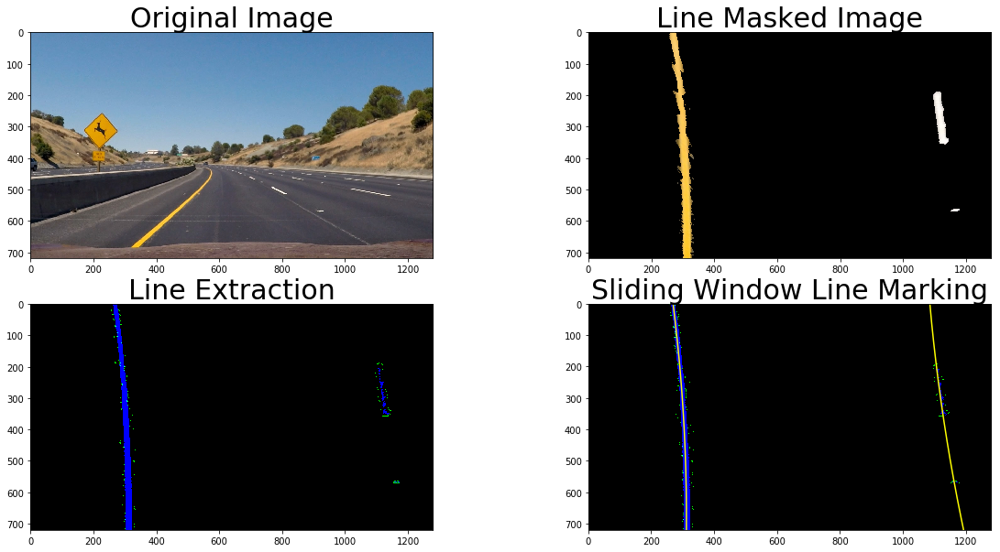

test3.jpg


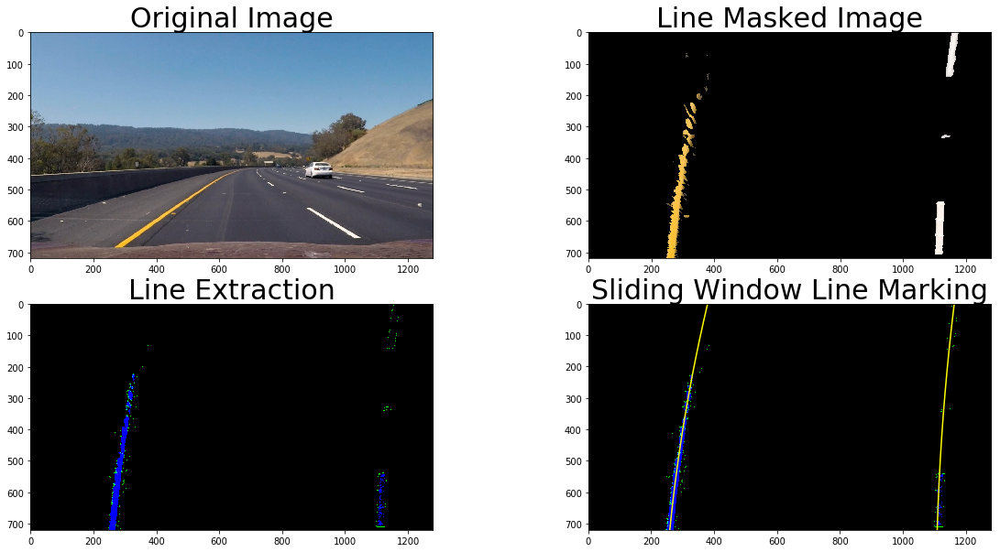

test4.jpg


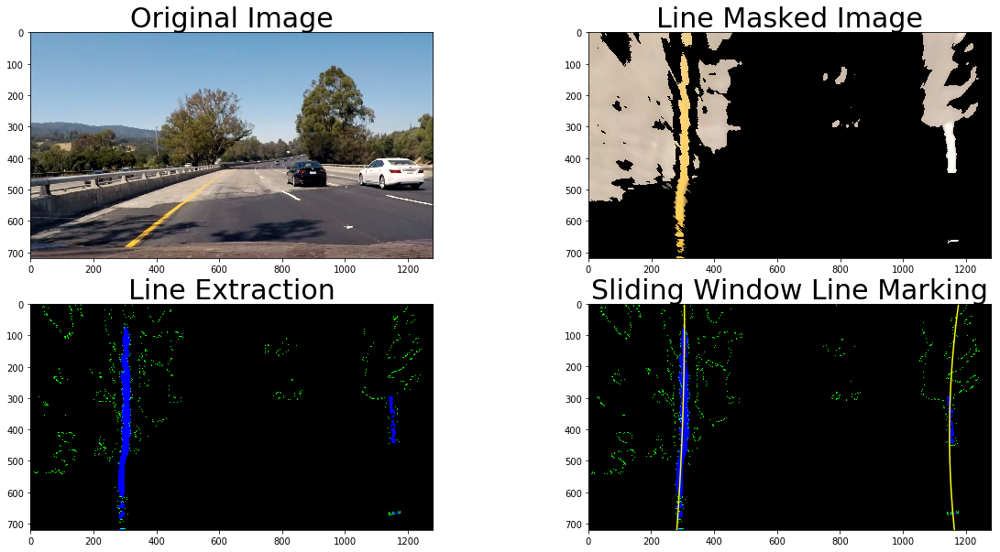

test5.jpg


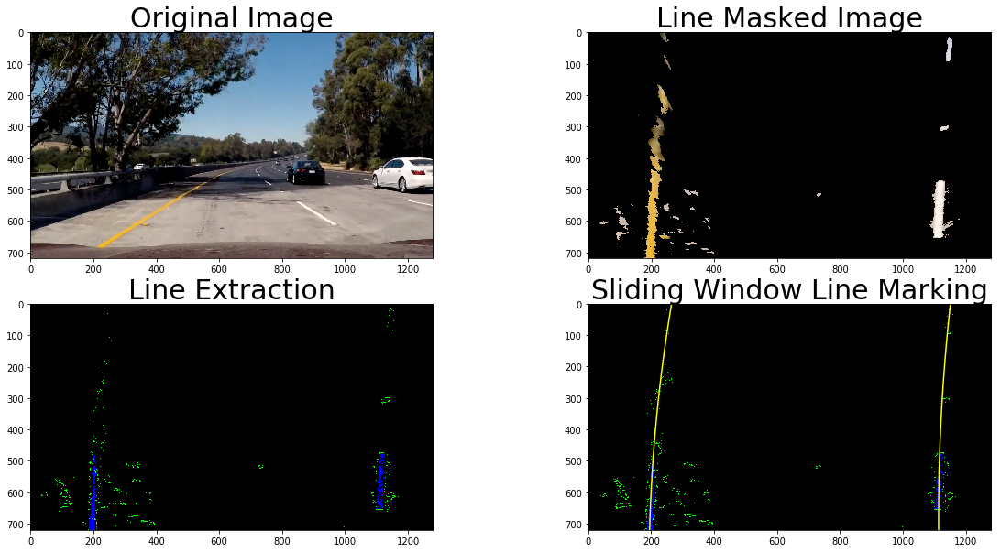

test6.jpg


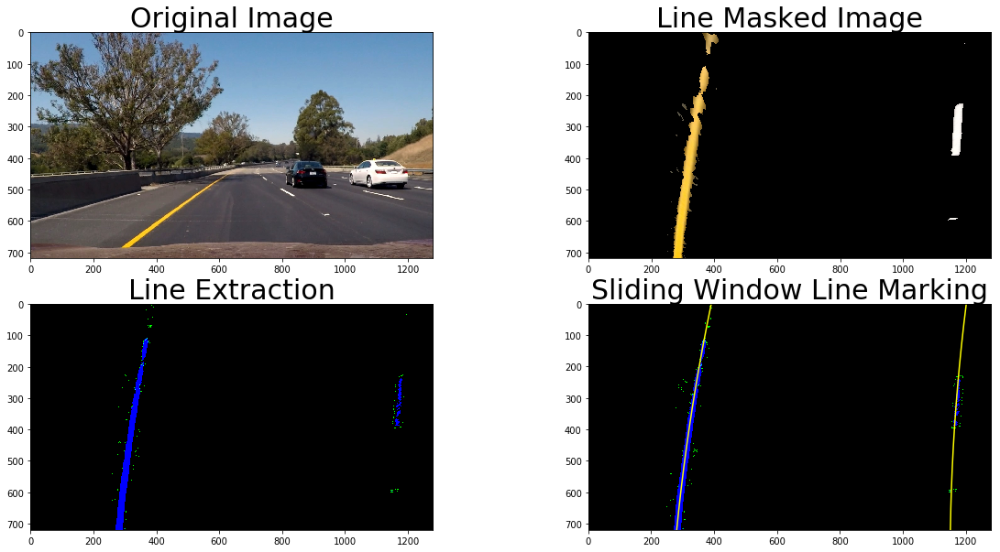

In [82]:
for image_name in os.listdir('test_images/'):
    print(image_name)
    
    img = mpimg.imread('test_images/' + image_name)
    warped_img = warp(img)
    masked_img = line_color_filter(warped_img)
    lines_img = lines_preprocessing(masked_img)
    left_fit, right_fit = get_line_fits(lines_img)
    
    f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 10))

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0] )
    left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]
    
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(masked_img)
    ax2.set_title('Line Masked Image', fontsize=30)
    ax3.imshow(lines_img)
    ax3.set_title('Line Extraction', fontsize=30)
    ax4.imshow(lines_img)
    ax4.plot(left_fitx, ploty, color='yellow')
    ax4.plot(right_fitx, ploty, color='yellow')
    ax4.set_xlim(0, lines_img.shape[1])
    ax4.set_ylim(lines_img.shape[0], 0)
    ax4.set_title('Sliding Window Line Marking', fontsize=30)
    plt.show()